In [1]:
import pandas as pd
import numpy as np
import shutil
import os
import torch
import librosa
import librosa.display
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm.notebook import tqdm

In [2]:
DATA_DIR = '../UrbanSound8K'
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using {DEVICE}")

Using cuda


In [3]:
metadata = pd.read_csv(f'{DATA_DIR}/metadata/UrbanSound8K.csv')
metadata["length"] = metadata["end"] - metadata["start"]
metadata.head()

,slice_file_name,fsID,start,end,salience,fold,classID,class,length
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark,0.317551
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing,4.000000
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing,4.000000
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing,4.000000
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing,4.000000


In [4]:
metadata["length"].describe()

count    8732.000000
mean        3.607904
std         0.973570
min         0.054517
25%         4.000000
50%         4.000000
75%         4.000000
max         4.000000
Name: length, dtype: float64

In [ ]:
from pathlib import Path
import shutil
from typing import List, Tuple


def unpack_audio(src_root: str | Path, dest_dir: str | Path):
    src_root = Path(src_root).resolve()
    dest_dir = Path(dest_dir).resolve()
    dest_dir.mkdir(parents=True, exist_ok=True)

    for root, _, files in __import__("os").walk(src_root):
        root_path = Path(root).resolve()

        for fname in files:
            src_file = root_path / fname

            if not src_file.is_file():
                continue
            if src_file.name.startswith('.'):
                continue

            target = dest_dir / src_file.name

            shutil.move(str(src_file), str(target))


In [ ]:
unpack_audio(
    os.path.join(DATA_DIR, 'audio'),
    os.path.join(DATA_DIR, 'audio_unpacked'), 
)

In [ ]:
def save_log_mel_spectrogram(
    df,
    audio_dir: str | Path,
    output_dir: str | Path,
    sr: int = 22050,
    n_mels: int = 128,
    n_fft: int = 2048,
    hop_length: int = 512,
    fmin: float = 0.0,
    fmax: float = None,
) -> None:

    audio_dir  = Path(audio_dir).resolve()
    output_dir = Path(output_dir).resolve()
    output_dir.mkdir(parents=True, exist_ok=True)

    for fname in tqdm(df['slice_file_name']):
        audio_path = audio_dir / fname
        if not audio_path.is_file():
            print(f"[SKIP] not found: {audio_path}")
            continue

        y, _ = librosa.load(str(audio_path), sr=sr, mono=True)

        mel = librosa.feature.melspectrogram(
            y=y, sr=sr,
            n_fft=n_fft,
            hop_length=hop_length,
            n_mels=n_mels,
            fmin=fmin,
            fmax=fmax,
        )

        # (n_mels, T)
        log_mel = librosa.power_to_db(mel, ref=np.max)

        stem = Path(fname).stem
        out_path = output_dir / f"{stem}.npy"
        np.save(str(out_path), log_mel)

    print(f"Saved {len(df)} spectrograms to {output_dir}")


save_log_mel_spectrogram(
    metadata,
    audio_dir=os.path.join(DATA_DIR, 'audio_unpacked'),
    output_dir=os.path.join(DATA_DIR, 'spectrograms'),
) 

  0%|          | 0/8732 [00:00<?, ?it/s]

/mnt/shared/miniconda3/envs/ml/lib/python3.11/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1323
  warnings.warn(
/mnt/shared/miniconda3/envs/ml/lib/python3.11/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1103
  warnings.warn(
/mnt/shared/miniconda3/envs/ml/lib/python3.11/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1523
  warnings.warn(
/mnt/shared/miniconda3/envs/ml/lib/python3.11/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1103
  warnings.warn(
/mnt/shared/miniconda3/envs/ml/lib/python3.11/site-packages/librosa/core/spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1523
  warnings.warn(


Saved 8732 spectrograms to /home/kirill/Files/IU_Cources/S26_GenAI/UrbanSound8K/spectrograms


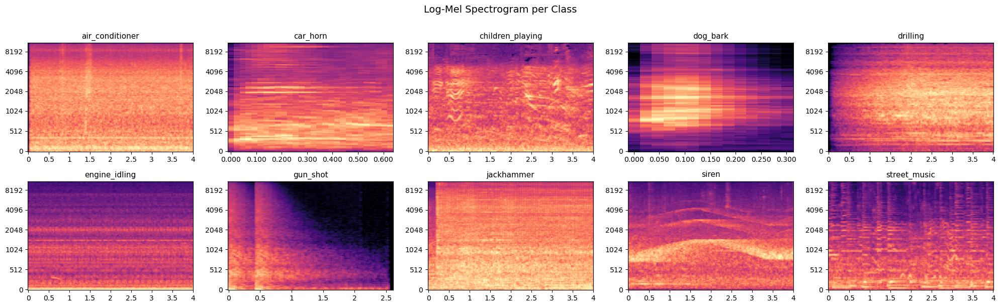

In [5]:

spec_dir = Path(os.path.join(DATA_DIR, 'spectrograms'))

class_samples = (
    metadata.groupby('classID', as_index=False)
    .first()[['classID', 'class', 'slice_file_name']]
    .sort_values('classID')
)

n_classes = len(class_samples)
cols = 5
rows = (n_classes + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 3))
axes = axes.flatten()

for ax, (_, row) in zip(axes, class_samples.iterrows()):
    stem = Path(row['slice_file_name']).stem
    npy_path = spec_dir / f"{stem}.npy"

    if not npy_path.is_file():
        ax.set_title(row['class'])
        ax.axis('off')
        continue

    log_mel = np.load(str(npy_path))
    librosa.display.specshow(
        log_mel,
        sr=22050,
        hop_length=512,
        x_axis='time',
        y_axis='mel',
        ax=ax,
        cmap='magma',
    )
    ax.set_title(row['class'], fontsize=11)
    ax.set_xlabel('')
    ax.set_ylabel('')

for ax in axes[n_classes:]:
    ax.axis('off')

fig.suptitle('Log-Mel Spectrogram per Class', fontsize=14, y=1.01)
plt.tight_layout()
plt.show()


In [6]:

import torch
from torch.utils.data import Dataset, DataLoader, random_split

# ── Fixed spectrogram width (pad / crop to this many time frames) ──────────────
SPEC_T = 176   # 4s at sr=22050, hop=512

class SpectrogramDataset(Dataset):
    """Loads pre-saved log-mel .npy files and their class labels."""

    def __init__(self, df, spec_dir: str | Path, spec_t: int = SPEC_T):
        self.spec_dir = Path(spec_dir).resolve()
        self.spec_t   = spec_t

        # keep only rows whose .npy actually exists
        rows = []
        for _, row in df.iterrows():
            p = self.spec_dir / f"{Path(row['slice_file_name']).stem}.npy"
            if p.is_file():
                rows.append((str(p), int(row['classID'])))
        self.samples = rows
        print(f"Dataset: {len(self.samples)} samples found.")

    def _pad_or_crop(self, x: np.ndarray) -> np.ndarray:
        """x: (n_mels, T)  →  (n_mels, spec_t)"""
        t = x.shape[1]
        if t >= self.spec_t:
            return x[:, :self.spec_t]
        # pad right with minimum value (silence in dB)
        pad = np.full((x.shape[0], self.spec_t - t), x.min(), dtype=x.dtype)
        return np.concatenate([x, pad], axis=1)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        path, label = self.samples[idx]
        log_mel = np.load(path)                       # (n_mels, T)
        log_mel = self._pad_or_crop(log_mel)          # (n_mels, spec_t)

        # Normalise to [-1, 1] from the typical dB range [-80, 0]
        log_mel = (log_mel + 40.0) / 40.0             # → roughly [-1, 1]

        x = torch.tensor(log_mel, dtype=torch.float32).unsqueeze(0)  # (1, n_mels, spec_t)
        y = torch.tensor(label,   dtype=torch.long)
        return x, y


dataset = SpectrogramDataset(metadata, spec_dir=os.path.join(DATA_DIR, 'spectrograms'))
n_val = max(1, int(0.1 * len(dataset)))
n_train = len(dataset) - n_val
train_ds, val_ds = random_split(dataset, [n_train, n_val],
                                generator=torch.Generator().manual_seed(42))

train_loader = DataLoader(train_ds, batch_size=64, shuffle=True,  num_workers=2, pin_memory=True)
val_loader = DataLoader(val_ds,   batch_size=64, shuffle=False, num_workers=2, pin_memory=True)
print(f"Train batches: {len(train_loader)}  |  Val batches: {len(val_loader)}")


Dataset: 8732 samples found.
Train batches: 123  |  Val batches: 14


In [9]:

import torch
import torch.nn as nn

# ── Hyperparameters ────────────────────────────────────────────────────────────
N_CLASSES  = 10
EMBED_DIM  = 32
LATENT_DIM = 128
BASE_CH    = 32   # channels in first conv layer; doubles each block


# ── Building blocks ────────────────────────────────────────────────────────────

class ResBlock(nn.Module):
    """
    Residual block:  Conv → BN → ReLU → Conv → BN  (+skip)
    Optionally changes spatial size or channel count via a 1×1 projection.
    """
    def __init__(self, in_ch: int, out_ch: int, stride: int = 1, transpose: bool = False):
        super().__init__()
        conv = nn.ConvTranspose2d if transpose else nn.Conv2d

        if transpose:
            # upsample: stride on the first conv, output_padding keeps sizes clean
            self.conv1 = conv(in_ch, out_ch, 3, stride=stride,
                              padding=1, output_padding=stride - 1)
        else:
            self.conv1 = conv(in_ch, out_ch, 3, stride=stride, padding=1)

        self.bn1   = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1) if not transpose \
                     else nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bn2   = nn.BatchNorm2d(out_ch)

        # projection shortcut when dimensions change
        self.skip = None
        if in_ch != out_ch or stride != 1:
            if transpose:
                self.skip = nn.Sequential(
                    nn.ConvTranspose2d(in_ch, out_ch, 1, stride=stride,
                                       output_padding=stride - 1),
                    nn.BatchNorm2d(out_ch),
                )
            else:
                self.skip = nn.Sequential(
                    nn.Conv2d(in_ch, out_ch, 1, stride=stride),
                    nn.BatchNorm2d(out_ch),
                )

    def forward(self, x):
        identity = x if self.skip is None else self.skip(x)
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        return self.relu(out + identity)


# ── Encoder ────────────────────────────────────────────────────────────────────

class Encoder(nn.Module):
    """
    4 × ResBlock (each halves spatial dims via stride=2).
    Class embedding is added (broadcast) before flattening.
    Output: latent vector z of shape (B, LATENT_DIM).
    """
    def __init__(self, in_ch=1, base_ch=BASE_CH,
                 embed_dim=EMBED_DIM, latent_dim=LATENT_DIM,
                 n_classes=N_CLASSES, spec_h=128, spec_t=SPEC_T):
        super().__init__()

        self.embedding = nn.Embedding(n_classes, embed_dim)

        ch = [base_ch * (2 ** i) for i in range(4)]   # [32, 64, 128, 256]
        self.blocks = nn.Sequential(
            ResBlock(in_ch,  ch[0], stride=2),   # 128×128 → 64×64
            ResBlock(ch[0],  ch[1], stride=2),   # 64×64  → 32×32
            ResBlock(ch[1],  ch[2], stride=2),   # 32×32  → 16×16
            ResBlock(ch[2],  ch[3], stride=2),   # 16×16  →  8×8
        )

        # spatial size after 4 stride-2 downsamples
        h_out = spec_h // 16
        t_out = spec_t // 16
        flat_dim = ch[3] * h_out * t_out

        # class embedding projected to same spatial shape for channel-wise concat
        self.embed_proj = nn.Linear(embed_dim, ch[3])

        self.fc = nn.Linear(flat_dim + ch[3], latent_dim)

    def forward(self, x, labels):
        feat = self.blocks(x)                         # (B, 256, h_out, t_out)
        flat = feat.flatten(1)                        # (B, flat_dim)

        emb  = self.embedding(labels)                 # (B, embed_dim)
        emb  = self.embed_proj(emb)                   # (B, 256)

        z = self.fc(torch.cat([flat, emb], dim=1))    # (B, latent_dim)
        return z


# ── Decoder ────────────────────────────────────────────────────────────────────

class Decoder(nn.Module):
    """
    Linear projection back to spatial feature map,
    then 4 × transposed ResBlocks (each doubles spatial dims).
    Class embedding is concatenated to z before projection.
    Output: reconstructed spectrogram (B, 1, spec_h, spec_t).
    """
    def __init__(self, out_ch=1, base_ch=BASE_CH,
                 embed_dim=EMBED_DIM, latent_dim=LATENT_DIM,
                 n_classes=N_CLASSES, spec_h=128, spec_t=SPEC_T):
        super().__init__()

        self.embedding = nn.Embedding(n_classes, embed_dim)

        ch = [base_ch * (2 ** i) for i in range(4)]   # [32, 64, 128, 256]
        self.h_out = spec_h // 16
        self.t_out = spec_t // 16
        self.start_ch = ch[3]

        self.fc = nn.Linear(latent_dim + embed_dim, ch[3] * self.h_out * self.t_out)

        self.blocks = nn.Sequential(
            ResBlock(ch[3], ch[2], stride=2, transpose=True),  #  8×8  → 16×16
            ResBlock(ch[2], ch[1], stride=2, transpose=True),  # 16×16 → 32×32
            ResBlock(ch[1], ch[0], stride=2, transpose=True),  # 32×32 → 64×64
            ResBlock(ch[0], ch[0], stride=2, transpose=True),  # 64×64 →128×128
        )

        self.head = nn.Sequential(
            nn.Conv2d(ch[0], out_ch, 1),
            nn.Tanh(),
        )

    def forward(self, z, labels):
        emb  = self.embedding(labels)                           # (B, embed_dim)
        x    = self.fc(torch.cat([z, emb], dim=1))             # (B, flat_dim)
        x    = x.view(-1, self.start_ch, self.h_out, self.t_out)
        x    = self.blocks(x)
        return self.head(x)                                     # (B, 1, H, T)


# ── Conditional Autoencoder ────────────────────────────────────────────────────

class ConditionalAE(nn.Module):
    def __init__(self, **kwargs):
        super().__init__()
        self.encoder = Encoder(**kwargs)
        self.decoder = Decoder(**kwargs)

    def forward(self, x, labels):
        z    = self.encoder(x, labels)
        x_hat = self.decoder(z, labels)
        return x_hat, z

    @torch.no_grad()
    def generate(self, labels, device, noise_std: float = 0.5):
        """Sample z ~ N(0, noise_std²) and decode conditioned on labels."""
        z = torch.randn(len(labels), LATENT_DIM, device=device) * noise_std
        return self.decoder(z, labels)


# ── Instantiate & sanity-check ─────────────────────────────────────────────────
model  = ConditionalAE().to(DEVICE)

# quick shape check
_x = torch.zeros(2, 1, 128, SPEC_T, device=DEVICE)
_y = torch.zeros(2, dtype=torch.long, device=DEVICE)
_out, _z = model(_x, _y)
print(f"Input : {_x.shape}")
print(f"Latent: {_z.shape}")
print(f"Output: {_out.shape}")
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Trainable parameters: {total_params:,}")


Input : torch.Size([2, 1, 128, 176])
Latent: torch.Size([2, 128])
Output: torch.Size([2, 1, 128, 176])
Trainable parameters: 8,416,065


In [ ]:

import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.utils.tensorboard import SummaryWriter
import torchvision

# ── Loss ───────────────────────────────────────────────────────────────────────

def reconstruction_loss(x_hat, x):
    """L1 on log-mel spectrograms."""
    return torch.nn.functional.l1_loss(x_hat, x)


# ── Training config ────────────────────────────────────────────────────────────
EPOCHS    = 150
LR        = 3e-4
CKPT_PATH = 'cae_best.pt'
LOG_DIR   = 'runs/cae'
PATIENCE = 15
ES_MIN_DELTA = 1e-4


optimizer = optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-4)
scheduler = CosineAnnealingLR(optimizer, T_max=EPOCHS, eta_min=1e-6)
writer    = SummaryWriter(log_dir=LOG_DIR)

# Log model graph once
_dummy_x = torch.zeros(1, 1, 128, SPEC_T, device=DEVICE)
_dummy_y = torch.zeros(1, dtype=torch.long, device=DEVICE)
writer.add_graph(model, (_dummy_x, _dummy_y))

# ── Training loop ──────────────────────────────────────────────────────────────
train_losses, val_losses = [], []
best_val = float('inf')
es_counter = 0

for epoch in tqdm(range(1, EPOCHS + 1)):

    # ── train ──
    model.train()
    running = 0.0
    for x, y in train_loader:
        x, y = x.to(DEVICE), y.to(DEVICE)
        x_hat, _ = model(x, y)
        loss = reconstruction_loss(x_hat, x)
        optimizer.zero_grad()
        loss.backward()
        nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optimizer.step()
        running += loss.item() * x.size(0)
    train_loss = running / len(train_ds)

    # ── validate ──
    model.eval()
    running = 0.0
    with torch.no_grad():
        for x, y in val_loader:
            x, y = x.to(DEVICE), y.to(DEVICE)
            x_hat, _ = model(x, y)
            running += reconstruction_loss(x_hat, x).item() * x.size(0)
    val_loss = running / len(val_ds)

    scheduler.step()
    current_lr = scheduler.get_last_lr()[0]
    train_losses.append(train_loss)
    val_losses.append(val_loss)

    # ── TensorBoard: scalars ──
    writer.add_scalars('Loss', {'train': train_loss, 'val': val_loss}, epoch)
    writer.add_scalar('LR', current_lr, epoch)

    # ── TensorBoard: gradient norms ──
    total_norm = 0.0
    for p in model.parameters():
        if p.grad is not None:
            total_norm += p.grad.data.norm(2).item() ** 2
    writer.add_scalar('Grad/norm', total_norm ** 0.5, epoch)

    # ── TensorBoard: spectrogram images every 10 epochs ──
    if epoch % 10 == 0 or epoch == 1:
        model.eval()
        with torch.no_grad():
            x_sample, y_sample = next(iter(val_loader))
            x_sample = x_sample[:8].to(DEVICE)
            y_sample = y_sample[:8].to(DEVICE)
            x_hat_sample, _ = model(x_sample, y_sample)

        # Normalise to [0,1] for image display
        def to_img(t):
            t = t - t.min(); t = t / (t.max() + 1e-8)
            return t  # (B, 1, H, T)

        grid_real = torchvision.utils.make_grid(to_img(x_sample), nrow=4)
        grid_recon = torchvision.utils.make_grid(to_img(x_hat_sample), nrow=4)
        writer.add_image('Spectrogram/real',          grid_real,  epoch)
        writer.add_image('Spectrogram/reconstruction', grid_recon, epoch)


    # ── Checkpoint ──
    if val_loss < best_val - ES_MIN_DELTA:
        best_val   = val_loss
        es_counter = 0
        torch.save(model.state_dict(), CKPT_PATH)
    else:
        es_counter += 1

    if es_counter >= PATIENCE:
        print(f"\nEarly stopping triggered at epoch {epoch}"
              f"(no improvement for {PATIENCE} epochs).")
        break

    if epoch % 5 == 0 or epoch == 1:
        print(f"Epoch {epoch:3d}/{EPOCHS}"
              f"train L1={train_loss:.4f}  val L1={val_loss:.4f}"
              f"lr={current_lr:.2e}  es={es_counter}/{PATIENCE}")

writer.close()
print(f"\nBest val L1: {best_val:.4f}  (saved → {CKPT_PATH})")
print(f"TensorBoard logs → {LOG_DIR}  (run: tensorboard --logdir {LOG_DIR})")


  0%|          | 0/150 [00:00<?, ?it/s]

Epoch   1/150train L1=0.1787  val L1=0.1319lr=3.00e-04  es=0/15


In [14]:

# ══════════════════════════════════════════════════════════════════════════════
# EVALUATION — helpers
# ══════════════════════════════════════════════════════════════════════════════

SR         = 22050
HOP_LENGTH = 512
N_MELS     = 128
N_FFT      = 2048

# ── Load best checkpoint ──────────────────────────────────────────────────────
model.load_state_dict(torch.load(CKPT_PATH, map_location=DEVICE))
model.eval()
print(f"Loaded checkpoint from {CKPT_PATH}")


# ── Denormalise spectrogram tensor → numpy dB array ──────────────────────────
def denorm(t: torch.Tensor) -> np.ndarray:
    """(B,1,H,T) tensor in [-1,1]  →  (B,H,T) numpy array in dB [-80,0]."""
    return (t.squeeze(1).cpu().numpy() * 40.0) - 40.0


# ── Griffin-Lim spectrogram → waveform ───────────────────────────────────────
def spec_to_wave(log_mel_db: np.ndarray,
                 sr: int = SR, n_fft: int = N_FFT,
                 hop_length: int = HOP_LENGTH,
                 n_iter: int = 60) -> np.ndarray:
    """
    log_mel_db : (n_mels, T) in dB
    returns    : waveform (T_samples,)
    """
    mel_power  = librosa.db_to_power(log_mel_db)          # linear power
    # Invert mel → linear STFT magnitude via pseudo-inverse of mel filterbank
    mel_to_stft = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=log_mel_db.shape[0])
    stft_mag    = np.dot(np.linalg.pinv(mel_to_stft), mel_power).clip(0)
    return librosa.griffinlim(stft_mag, n_iter=n_iter, hop_length=hop_length)


# ── Collect val-set batches (GT + reconstruction) ────────────────────────────
all_gt, all_recon, all_labels = [], [], []

with torch.no_grad():
    for x, y in tqdm(val_loader, desc="Collecting reconstructions"):
        x, y  = x.to(DEVICE), y.to(DEVICE)
        x_hat, _ = model(x, y)
        all_gt.append(x.cpu())
        all_recon.append(x_hat.cpu())
        all_labels.append(y.cpu())

gt_specs    = torch.cat(all_gt)      # (N,1,128,SPEC_T)
recon_specs = torch.cat(all_recon)
labels_val  = torch.cat(all_labels)

print(f"Val samples collected: {len(gt_specs)}")


Loaded checkpoint from cae_best.pt


Val samples collected: 873


In [15]:

import torch.nn.functional as F

# ══════════════════════════════════════════════════════════════════════════════
# RECONSTRUCTION METRICS
# ══════════════════════════════════════════════════════════════════════════════

# ── 1. Log-mel L1 ─────────────────────────────────────────────────────────────
logmel_l1 = F.l1_loss(recon_specs, gt_specs).item()


# ── 2. Multi-Resolution STFT Loss ─────────────────────────────────────────────
def stft_mag(wave: torch.Tensor, n_fft: int, hop: int) -> torch.Tensor:
    """Returns magnitude spectrogram for a batch of waveforms (B, T)."""
    w = torch.hann_window(n_fft, device=wave.device)
    S = torch.stft(wave, n_fft=n_fft, hop_length=hop,
                   win_length=n_fft, window=w, return_complex=True)
    return S.abs()                         # (B, F, T)


def mr_stft_loss(w_gt: torch.Tensor, w_hat: torch.Tensor,
                 fft_sizes=(512, 1024, 2048)) -> float:
    """
    Spectral convergence + log-magnitude L1 averaged over multiple resolutions.
    w_gt / w_hat : (N, T_samples) float tensors on CPU.
    """
    total = 0.0
    for n in fft_sizes:
        hop = n // 4
        mg  = stft_mag(w_gt,  n, hop)
        mh  = stft_mag(w_hat, n, hop)
        # spectral convergence
        sc  = (mg - mh).norm() / (mg.norm() + 1e-8)
        # log magnitude L1
        lm  = F.l1_loss(torch.log(mg + 1e-7), torch.log(mh + 1e-7))
        total += (sc + lm).item()
    return total / len(fft_sizes)


# ── 3. SI-SDR ─────────────────────────────────────────────────────────────────
def si_sdr(target: np.ndarray, estimate: np.ndarray, eps: float = 1e-8) -> float:
    """Scale-Invariant Signal-to-Distortion Ratio (dB)."""
    t = target  - target.mean()
    e = estimate - estimate.mean()
    alpha   = np.dot(e, t) / (np.dot(t, t) + eps)
    proj    = alpha * t
    noise   = e - proj
    return 10 * np.log10((proj ** 2).mean() / ((noise ** 2).mean() + eps) + eps)


# ── Convert val spectrograms → waveforms (Griffin-Lim) ───────────────────────
print("Reconstructing waveforms via Griffin-Lim …")
gt_dbs    = denorm(gt_specs)      # (N, 128, SPEC_T)
recon_dbs = denorm(recon_specs)

waves_gt, waves_hat = [], []
for i in tqdm(range(len(gt_dbs)), desc="Griffin-Lim"):
    waves_gt.append(spec_to_wave(gt_dbs[i]))
    waves_hat.append(spec_to_wave(recon_dbs[i]))

# Pad/trim to equal length
min_len = min(min(w.shape[0] for w in waves_gt),
              min(w.shape[0] for w in waves_hat))
wgt  = torch.tensor(np.stack([w[:min_len] for w in waves_gt]),  dtype=torch.float32)
what = torch.tensor(np.stack([w[:min_len] for w in waves_hat]), dtype=torch.float32)

# Compute metrics
mr_stft = mr_stft_loss(wgt, what)
si_sdr_scores = [si_sdr(wgt[i].numpy(), what[i].numpy()) for i in range(len(wgt))]
mean_si_sdr = float(np.mean(si_sdr_scores))

print(f"\n── Reconstruction Metrics ──────────────────")
print(f"  Log-mel L1          : {logmel_l1:.4f}")
print(f"  MR-STFT Loss        : {mr_stft:.4f}")
print(f"  SI-SDR              : {mean_si_sdr:.2f} dB")


Reconstructing waveforms via Griffin-Lim …


Griffin-Lim:   0%|          | 0/873 [00:00<?, ?it/s]


── Reconstruction Metrics ──────────────────
  Log-mel L1          : 0.0697
  MR-STFT Loss        : 1.7064
  SI-SDR              : -37.20 dB


In [16]:

from scipy import linalg as sla

# ══════════════════════════════════════════════════════════════════════════════
# GENERATION METRICS  (FAD + Embedding Diversity)
# We use a lightweight CNN encoder as the "audio embedding" model
# (avoids the heavy VGGish dependency; swap in VGGish if desired).
# ══════════════════════════════════════════════════════════════════════════════

# ── Lightweight embedding model (encoder of the trained CAE) ─────────────────
class EmbeddingExtractor(nn.Module):
    """Wraps the trained encoder; returns z without the class conditioning
    by feeding a dummy zero-label — we only want spectral features."""
    def __init__(self, encoder: Encoder):
        super().__init__()
        self.encoder = encoder

    @torch.no_grad()
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        dummy_labels = torch.zeros(x.size(0), dtype=torch.long, device=x.device)
        return self.encoder(x, dummy_labels)   # (B, LATENT_DIM)


embedder = EmbeddingExtractor(model.encoder).to(DEVICE)
embedder.eval()


def get_embeddings(specs: torch.Tensor, batch_size: int = 128) -> np.ndarray:
    """specs: (N,1,H,T)  →  embeddings: (N, LATENT_DIM)"""
    embs = []
    for i in range(0, len(specs), batch_size):
        batch = specs[i:i+batch_size].to(DEVICE)
        embs.append(embedder(batch).cpu().numpy())
    return np.concatenate(embs, axis=0)


# ── FAD helper ────────────────────────────────────────────────────────────────
def compute_fad(emb_real: np.ndarray, emb_fake: np.ndarray) -> float:
    """
    Fréchet Audio Distance between two sets of embeddings.
    Mirrors FID but on audio latents.
    """
    mu_r, sigma_r = emb_real.mean(0), np.cov(emb_real, rowvar=False)
    mu_f, sigma_f = emb_fake.mean(0), np.cov(emb_fake, rowvar=False)

    diff  = mu_r - mu_f
    # Symmetric matrix square root
    covmean, _ = sla.sqrtm(sigma_r @ sigma_f, disp=False)
    if np.iscomplexobj(covmean):          # numerical fix
        covmean = covmean.real
    fad = float(diff @ diff + np.trace(sigma_r + sigma_f - 2 * covmean))
    return fad


# ── Embedding Diversity ───────────────────────────────────────────────────────
def embedding_diversity(embs: np.ndarray) -> float:
    """Mean std across the embedding dimensions — higher = more diverse."""
    return float(embs.std(axis=0).mean())


# ── Generate one fake sample per real val sample (same class labels) ─────────
print("Generating fake spectrograms …")
fake_specs_list = []
with torch.no_grad():
    for i in range(0, len(labels_val), 128):
        lbl = labels_val[i:i+128].to(DEVICE)
        fake = model.generate(lbl, device=DEVICE, noise_std=0.5)
        fake_specs_list.append(fake.cpu())
fake_specs = torch.cat(fake_specs_list)   # (N,1,128,SPEC_T)

# ── Extract embeddings ────────────────────────────────────────────────────────
print("Extracting embeddings …")
emb_real = get_embeddings(gt_specs)
emb_fake = get_embeddings(fake_specs)

# ── Compute metrics ───────────────────────────────────────────────────────────
fad             = compute_fad(emb_real, emb_fake)
div_real        = embedding_diversity(emb_real)
div_fake        = embedding_diversity(emb_fake)

print(f"\n── Generation Metrics ──────────────────────")
print(f"  FAD                 : {fad:.4f}  (lower is better)")
print(f"  Diversity (real)    : {div_real:.4f}")
print(f"  Diversity (fake)    : {div_fake:.4f}")


Generating fake spectrograms …
Extracting embeddings …
Extracting embeddings …

── Generation Metrics ──────────────────────
  FAD                 : 28404.9997  (lower is better)
  Diversity (real)    : 12.6768
  Diversity (fake)    : 0.5105

── Generation Metrics ──────────────────────
  FAD                 : 28404.9997  (lower is better)
  Diversity (real)    : 12.6768
  Diversity (fake)    : 0.5105


/tmp/ipykernel_162628/2908459820.py:47: DeprecationWarning: The `disp` argument is deprecated and will be removed in SciPy 1.18.0.
  covmean, _ = sla.sqrtm(sigma_r @ sigma_f, disp=False)


          Metric       Category        Value
    Log-mel L1 ↓ Reconstruction     0.069689
  MR-STFT Loss ↓ Reconstruction     1.706386
   SI-SDR (dB) ↑ Reconstruction   -37.204237
           FAD ↓     Generation 28404.999749
Diversity real ↑     Generation    12.676758
Diversity fake ↑     Generation     0.510482


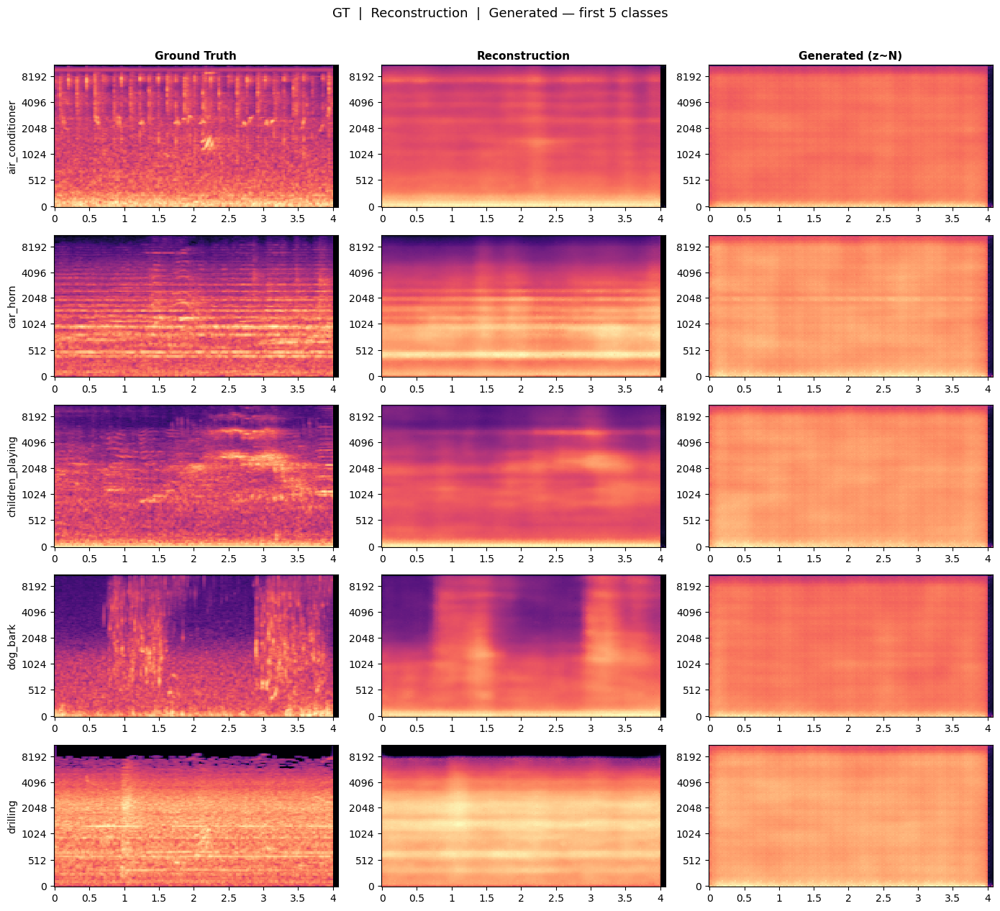

Evaluation metrics written to TensorBoard.


In [17]:

# ══════════════════════════════════════════════════════════════════════════════
# RESULTS SUMMARY + VISUALISATION
# ══════════════════════════════════════════════════════════════════════════════

import pandas as pd

results = pd.DataFrame({
    "Metric":    ["Log-mel L1 ↓", "MR-STFT Loss ↓", "SI-SDR (dB) ↑",
                  "FAD ↓", "Diversity real ↑", "Diversity fake ↑"],
    "Category":  ["Reconstruction"] * 3 + ["Generation"] * 3,
    "Value":     [logmel_l1, mr_stft, mean_si_sdr, fad, div_real, div_fake],
})
print(results.to_string(index=False))

# ── Visual: GT vs Reconstruction vs Generated (one per class) ─────────────────
id2name = metadata.set_index('classID')['class'].drop_duplicates().to_dict()
n_show  = 5   # classes to show

fig, axes = plt.subplots(n_show, 3, figsize=(14, n_show * 2.5))
col_titles = ['Ground Truth', 'Reconstruction', 'Generated (z~N)']

for row_i in range(n_show):
    # pick first val sample of this class
    mask = (labels_val == row_i).nonzero(as_tuple=True)[0]
    if len(mask) == 0:
        for ax in axes[row_i]: ax.axis('off')
        continue
    idx = mask[0].item()

    specs_to_show = [
        denorm(gt_specs[idx:idx+1])[0],
        denorm(recon_specs[idx:idx+1])[0],
        denorm(fake_specs[idx:idx+1])[0],
    ]

    for col_i, (spec, title) in enumerate(zip(specs_to_show, col_titles)):
        ax = axes[row_i, col_i]
        librosa.display.specshow(spec, sr=SR, hop_length=HOP_LENGTH,
                                 x_axis='time', y_axis='mel',
                                 ax=ax, cmap='magma')
        if row_i == 0:
            ax.set_title(title, fontsize=11, fontweight='bold')
        if col_i == 0:
            ax.set_ylabel(id2name.get(row_i, str(row_i)), fontsize=10)
        else:
            ax.set_ylabel('')
        ax.set_xlabel('')

fig.suptitle('GT  |  Reconstruction  |  Generated — first 5 classes',
             fontsize=13, y=1.01)
plt.tight_layout()
plt.show()

# ── Log all metrics to TensorBoard ───────────────────────────────────────────
eval_writer = SummaryWriter(log_dir=LOG_DIR)
eval_writer.add_scalar('Eval/LogMel_L1',       logmel_l1,    0)
eval_writer.add_scalar('Eval/MR_STFT',         mr_stft,      0)
eval_writer.add_scalar('Eval/SI_SDR',          mean_si_sdr,  0)
eval_writer.add_scalar('Eval/FAD',             fad,          0)
eval_writer.add_scalar('Eval/Diversity_real',  div_real,     0)
eval_writer.add_scalar('Eval/Diversity_fake',  div_fake,     0)
eval_writer.close()
print("Evaluation metrics written to TensorBoard.")



════════════════════════════════════════════════════════════
  Class 0: AIR_CONDITIONER
════════════════════════════════════════════════════════════


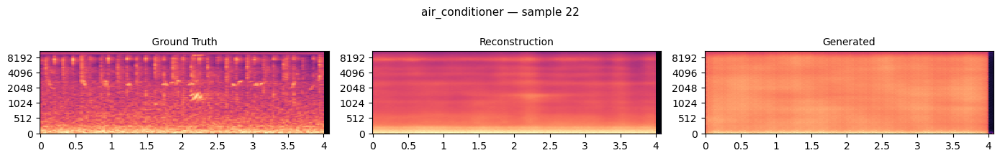

▶ Ground Truth


▶ Reconstruction


▶ Generated


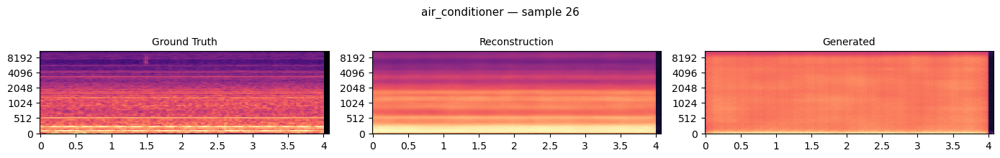

▶ Ground Truth


▶ Reconstruction


▶ Generated


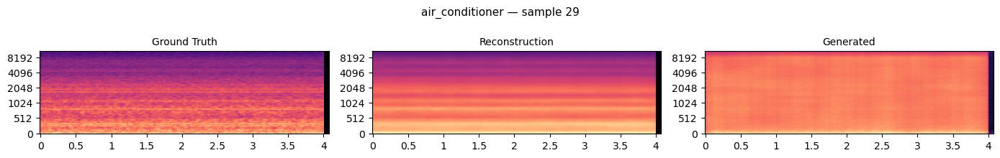

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 1: CAR_HORN
════════════════════════════════════════════════════════════


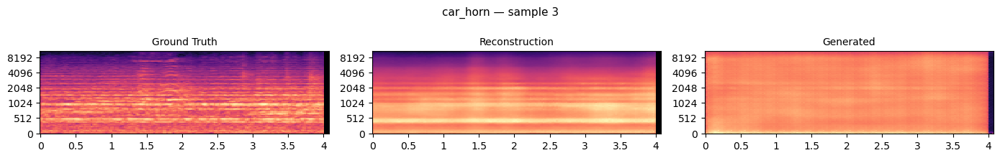

▶ Ground Truth


▶ Reconstruction


▶ Generated


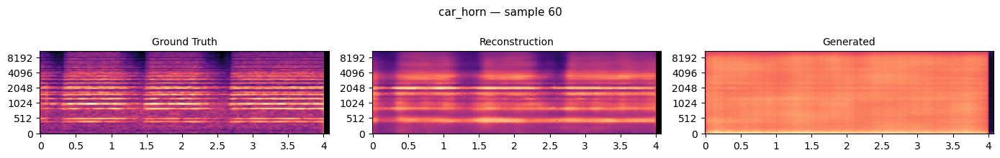

▶ Ground Truth


▶ Reconstruction


▶ Generated


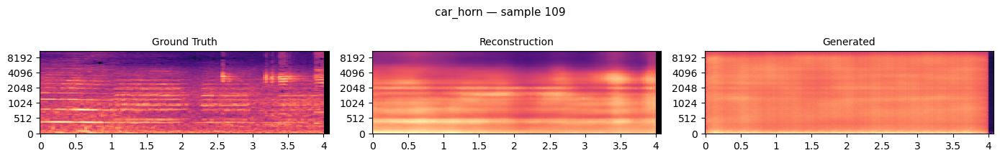

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 2: CHILDREN_PLAYING
════════════════════════════════════════════════════════════


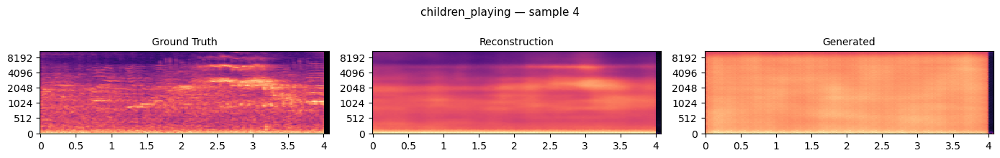

▶ Ground Truth


▶ Reconstruction


▶ Generated


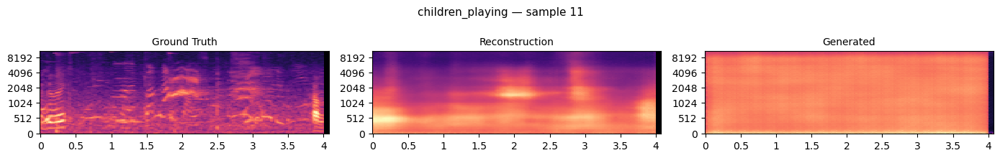

▶ Ground Truth


▶ Reconstruction


▶ Generated


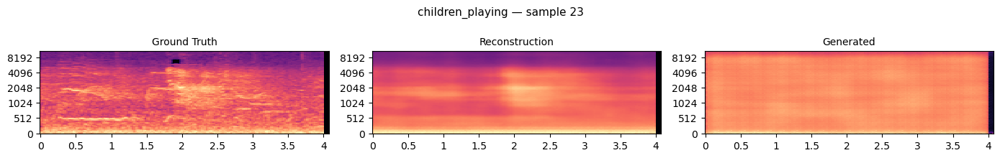

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 3: DOG_BARK
════════════════════════════════════════════════════════════


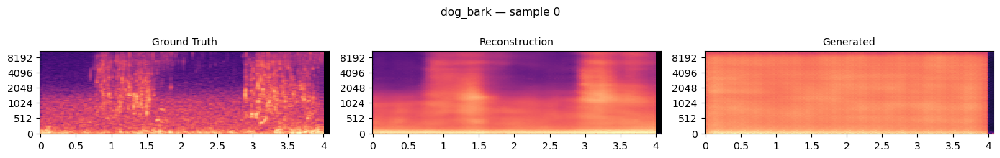

▶ Ground Truth


▶ Reconstruction


▶ Generated


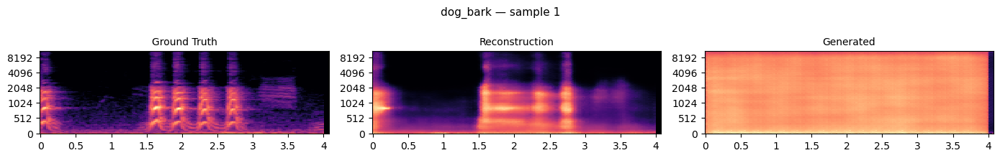

▶ Ground Truth


▶ Reconstruction


▶ Generated


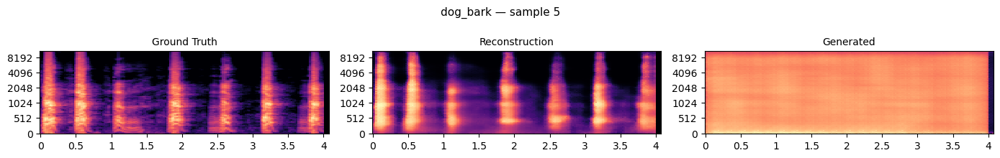

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 4: DRILLING
════════════════════════════════════════════════════════════


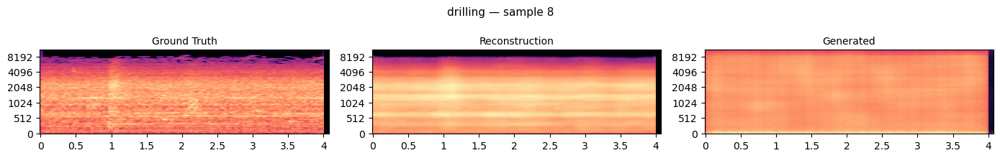

▶ Ground Truth


▶ Reconstruction


▶ Generated


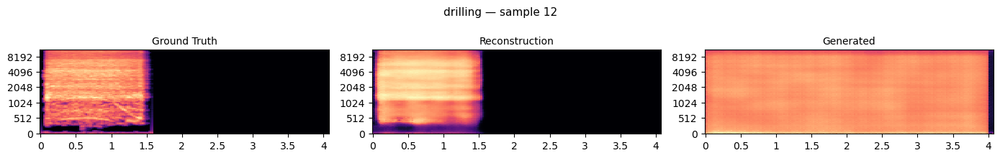

▶ Ground Truth


▶ Reconstruction


▶ Generated


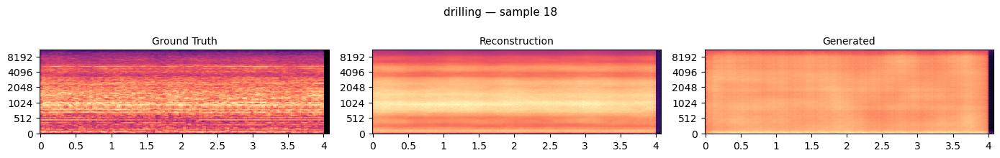

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 5: ENGINE_IDLING
════════════════════════════════════════════════════════════


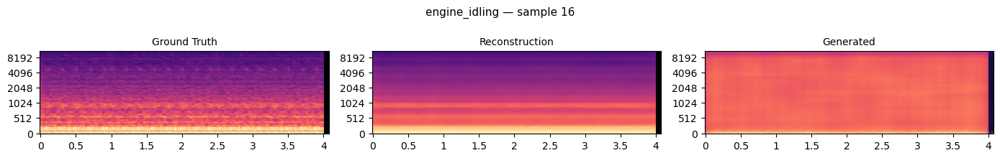

▶ Ground Truth


▶ Reconstruction


▶ Generated


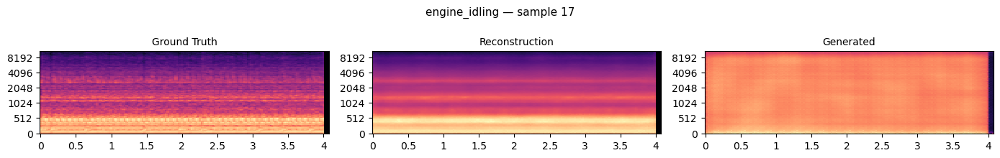

▶ Ground Truth


▶ Reconstruction


▶ Generated


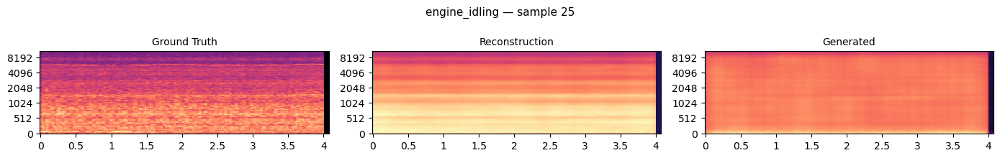

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 6: GUN_SHOT
════════════════════════════════════════════════════════════


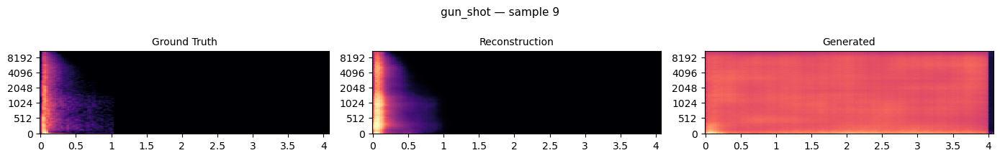

▶ Ground Truth


▶ Reconstruction


▶ Generated


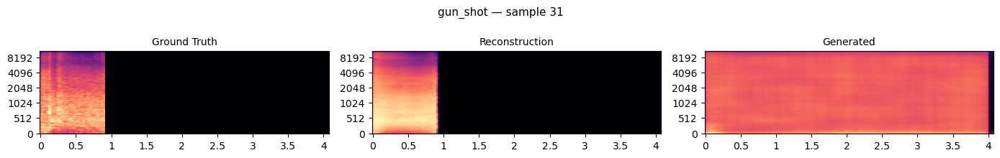

▶ Ground Truth


▶ Reconstruction


▶ Generated


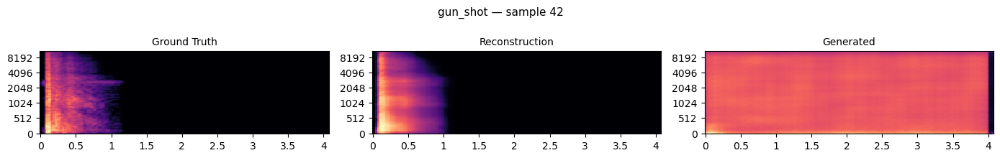

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 7: JACKHAMMER
════════════════════════════════════════════════════════════


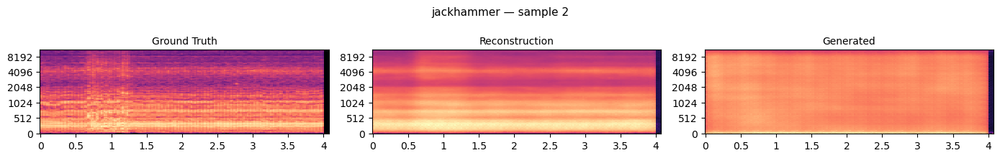

▶ Ground Truth


▶ Reconstruction


▶ Generated


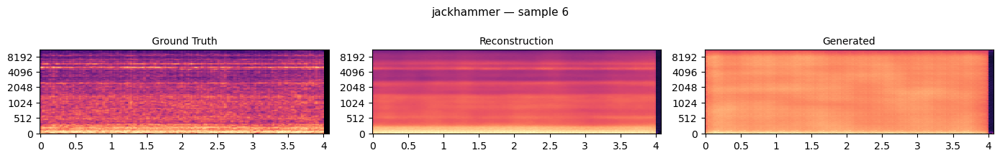

▶ Ground Truth


▶ Reconstruction


▶ Generated


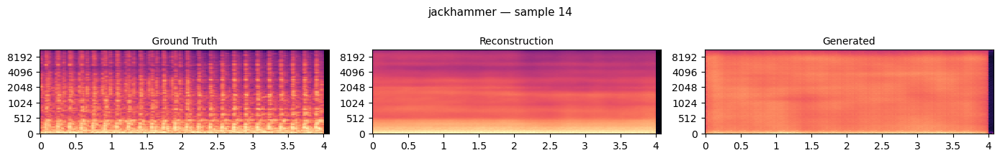

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 8: SIREN
════════════════════════════════════════════════════════════


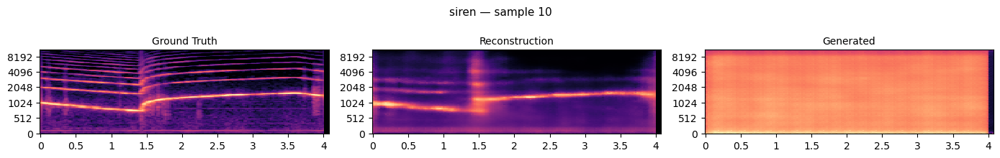

▶ Ground Truth


▶ Reconstruction


▶ Generated


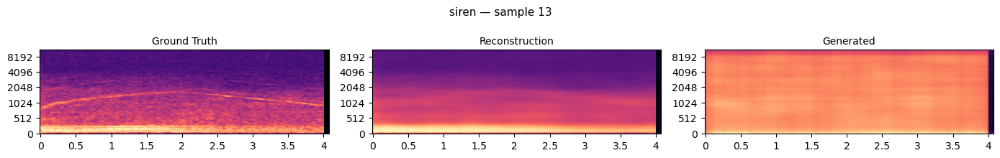

▶ Ground Truth


▶ Reconstruction


▶ Generated


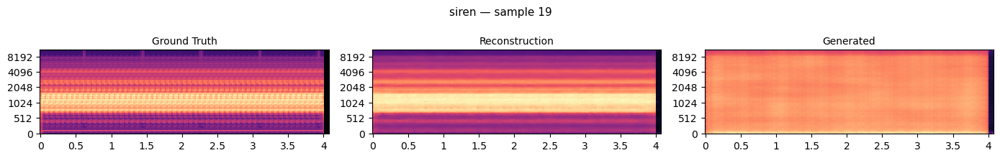

▶ Ground Truth


▶ Reconstruction


▶ Generated



════════════════════════════════════════════════════════════
  Class 9: STREET_MUSIC
════════════════════════════════════════════════════════════


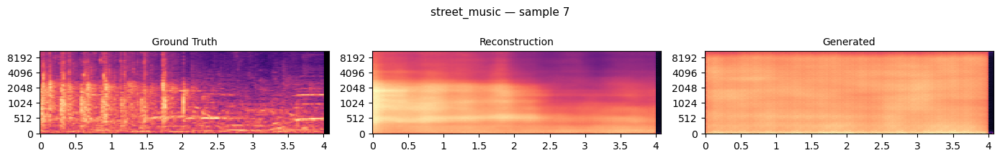

▶ Ground Truth


▶ Reconstruction


▶ Generated


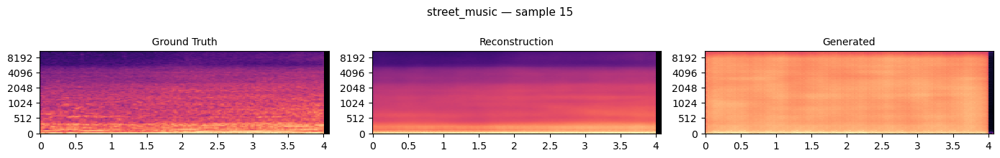

▶ Ground Truth


▶ Reconstruction


▶ Generated


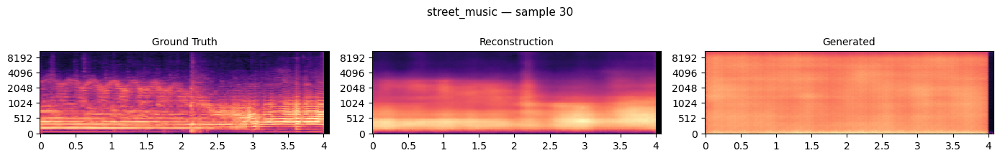

▶ Ground Truth


▶ Reconstruction


▶ Generated


In [18]:
import IPython.display as ipd

# ══════════════════════════════════════════════════════════════════════════════
# AUDIO PLAYBACK — Reconstruction & Generation
# ══════════════════════════════════════════════════════════════════════════════

N_SHOW     = 3   # samples per class to display
NOISE_STD  = 0.5
id2name    = metadata.set_index('classID')['class'].drop_duplicates().to_dict()

model.eval()

for class_id in range(N_CLASSES):
    mask = (labels_val == class_id).nonzero(as_tuple=True)[0]
    if len(mask) == 0:
        continue

    class_name = id2name.get(class_id, str(class_id))
    print(f"\n{'═'*60}")
    print(f"  Class {class_id}: {class_name.upper()}")
    print(f"{'═'*60}")

    indices = mask[:N_SHOW].tolist()

    for sample_idx in indices:
        gt_spec_np    = denorm(gt_specs[sample_idx:sample_idx+1])[0]     # (128, T)
        recon_spec_np = denorm(recon_specs[sample_idx:sample_idx+1])[0]

        # ── Generate a fresh sample for this class ──
        with torch.no_grad():
            lbl  = torch.tensor([class_id], dtype=torch.long, device=DEVICE)
            gen_spec_t = model.generate(lbl, device=DEVICE, noise_std=NOISE_STD)
        gen_spec_np = denorm(gen_spec_t.cpu())[0]

        # ── Waveforms ──
        w_gt    = spec_to_wave(gt_spec_np)
        w_recon = spec_to_wave(recon_spec_np)
        w_gen   = spec_to_wave(gen_spec_np)

        # ── Spectrogram strip ──
        fig, axes = plt.subplots(1, 3, figsize=(14, 2.2))
        for ax, spec, title in zip(
            axes,
            [gt_spec_np, recon_spec_np, gen_spec_np],
            ['Ground Truth', 'Reconstruction', 'Generated'],
        ):
            librosa.display.specshow(spec, sr=SR, hop_length=HOP_LENGTH,
                                     x_axis='time', y_axis='mel',
                                     ax=ax, cmap='magma')
            ax.set_title(title, fontsize=10)
            ax.set_xlabel(''); ax.set_ylabel('')
        fig.suptitle(f'{class_name} — sample {sample_idx}', fontsize=11)
        plt.tight_layout()
        plt.show()

        # ── Audio players ──
        print("▶ Ground Truth")
        display(ipd.Audio(w_gt,    rate=SR, normalize=True))
        print("▶ Reconstruction")
        display(ipd.Audio(w_recon, rate=SR, normalize=True))
        print("▶ Generated")
        display(ipd.Audio(w_gen,   rate=SR, normalize=True))
